<a href="https://colab.research.google.com/github/abhishekpythoninmakes/A7BC2/blob/master/Copy_of_Extracting_Text_from_Images_Completed.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import kagglehub
dataset_path = kagglehub.dataset_download('robikscube/textocr-text-extraction-from-images-dataset')
print(dataset_path)

print('Data source import complete.')
print(dataset_path)

/root/.cache/kagglehub/datasets/robikscube/textocr-text-extraction-from-images-dataset/versions/2
Data source import complete.
/root/.cache/kagglehub/datasets/robikscube/textocr-text-extraction-from-images-dataset/versions/2


# Extracting Text from Images in Python

<img src="https://media.arxiv-vanity.com/render-output/6158804/images/fig_2_no_trademarks.png" alt="text to images" width="600" height="600">


In [ ]:
# !pip install numpy

In [ ]:
import pandas as pd
import numpy as np

from glob import glob
from tqdm.notebook import tqdm

import matplotlib.pyplot as plt
from PIL import Image

plt.style.use('ggplot')

# Outline
1. Take a look at the data
2. Extract text from images:
    - pytesseract
    - easyocr
    - keras_ocr
3. Run on a few examples and compare the results

In [ ]:
# !pip install --upgrade pandas pyarrow fastparquet


In [ ]:
import glob

dataset_path = "/root/.cache/kagglehub/datasets/robikscube/textocr-text-extraction-from-images-dataset/versions/2"  # Use the printed path

annot = pd.read_parquet(f"{dataset_path}/annot.parquet")
imgs = pd.read_parquet(f"{dataset_path}/img.parquet")
img_fns = glob.glob(f"{dataset_path}/train_val_images/train_images/*")


# Plot Example Images

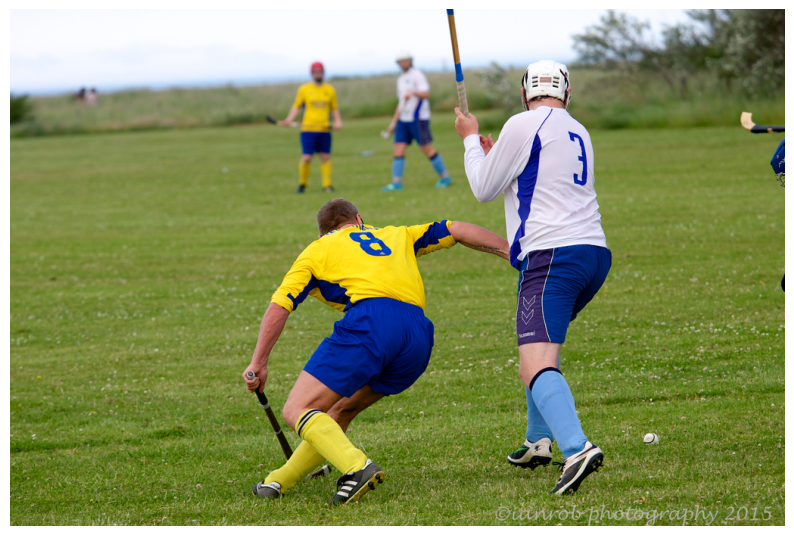

In [ ]:
fig, ax = plt.subplots(figsize=(10, 10))
ax.imshow(plt.imread(img_fns[0]))
ax.axis('off')
plt.show()

In [ ]:
image_id = img_fns[0].split('/')[-1].split('.')[0]
annot.query('image_id == @image_id')

,id,image_id,bbox,utf8_string,points,area
970083,aba287a780b51467_1,aba287a780b51467,"[670.4, 424.39, 24.63, 11.5]",.,"[670.4, 427.84, 694.54, 424.39, 695.03, 432.77...",283.25
970084,aba287a780b51467_2,aba287a780b51467,"[736.08, 159.39, 27.59, 76.2]",3,"[736.08, 159.39, 763.02, 163.33, 763.67, 235.5...",2102.36
970085,aba287a780b51467_3,aba287a780b51467,"[441.47, 289.45, 70.94, 43.03]",8,"[441.47, 295.36, 476.28, 289.45, 512.41, 323.6...",3052.55
970086,aba287a780b51467_4,aba287a780b51467,"[414.21, 288.14, 23.65, 13.79]",.,"[414.21, 291.09, 437.86, 288.14, 436.87, 299.6...",326.13
970087,aba287a780b51467_5,aba287a780b51467,"[448.69, 282.22, 41.06, 13.14]",.,"[448.69, 282.22, 489.75, 283.54, 489.75, 295.3...",539.53
970088,aba287a780b51467_6,aba287a780b51467,"[396.24, 119.17, 24.9, 11.89]",.,"[396.61, 119.55, 421.14, 119.17, 420.57, 130.4...",296.06
970089,aba287a780b51467_7,aba287a780b51467,"[624.68, 312.74, 23.0, 6.4]",.,"[624.68, 316.14, 647.68, 319.14, 647.48, 315.3...",147.20
970090,aba287a780b51467_8,aba287a780b51467,"[606.38, 309.74, 17.4, 6.2]",.,"[606.38, 313.34, 623.58, 315.94, 623.78, 312.2...",107.88
970091,aba287a780b51467_9,aba287a780b51467,"[612.88, 313.94, 13.8, 6.0]",.,"[612.88, 317.84, 626.58, 319.94, 626.68, 316.0...",82.80
970092,aba287a780b51467_10,aba287a780b51467,"[627.28, 315.84, 13.7, 6.2]",.,"[627.28, 319.94, 640.98, 322.04, 640.88, 318.1...",84.94


## Display for first 25 images

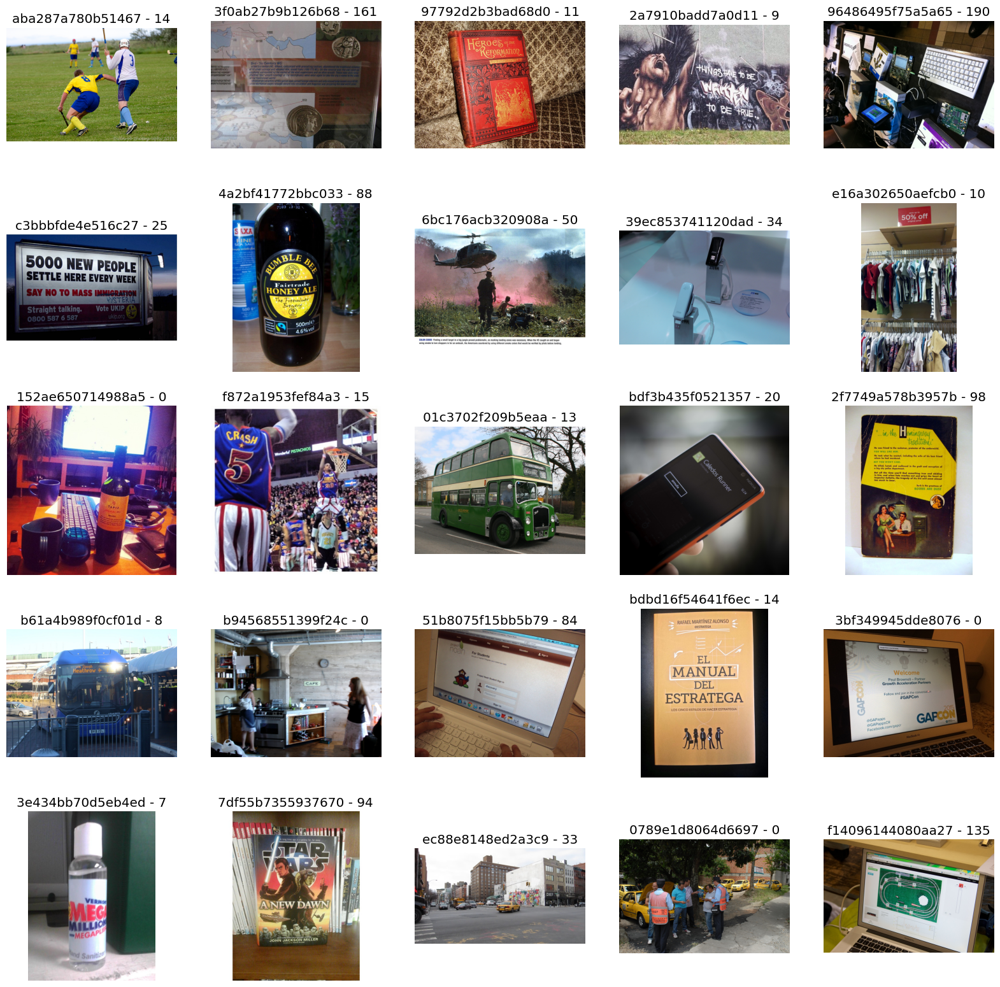

In [ ]:
fig, axs = plt.subplots(5, 5, figsize=(20, 20))
axs = axs.flatten()
for i in range(25):
    axs[i].imshow(plt.imread(img_fns[i]))
    axs[i].axis('off')
    image_id = img_fns[i].split('/')[-1].rstrip('.jpg')
    n_annot = len(annot.query('image_id == @image_id'))
    axs[i].set_title(f'{image_id} - {n_annot}')
plt.show()

# Method 1: pytesseract

In [ ]:
# !apt-get update
# !apt-get install -y tesseract-ocr
# !pip install pytesseract



In [ ]:
import pytesseract

# Example call
print(pytesseract.image_to_string(img_fns[11], lang='eng'))

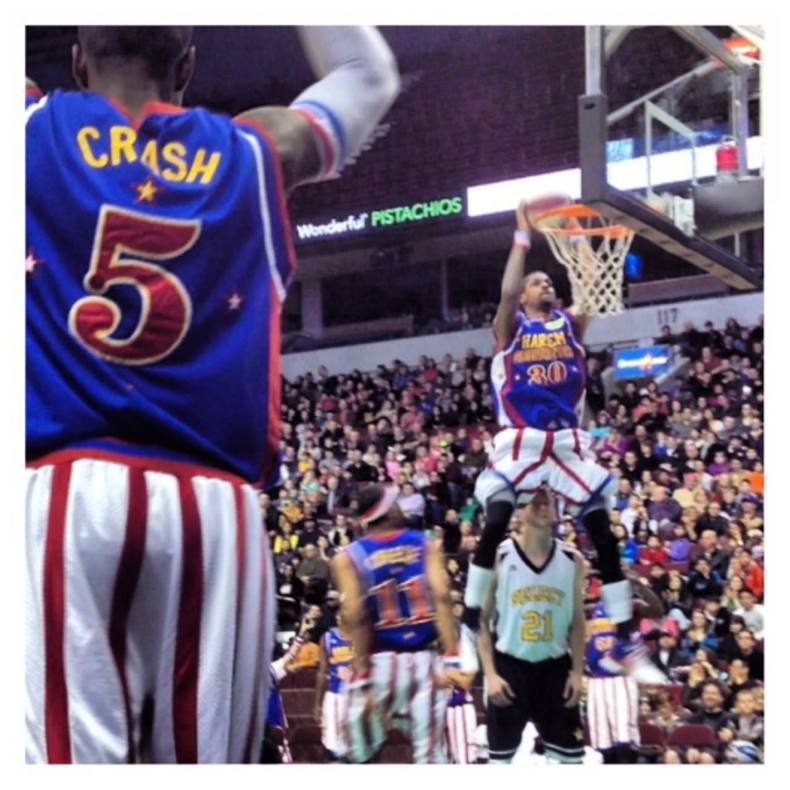

In [ ]:
fig, ax = plt.subplots(figsize=(10,10))
ax.imshow(plt.imread(img_fns[11]))
ax.axis('off')
plt.show()

# Method 2: easyocr

In [ ]:
# !pip install easyocr


In [ ]:
import easyocr

reader = easyocr.Reader(['en'], gpu = True)

In [ ]:
results = reader.readtext(img_fns[11])

In [ ]:
pd.DataFrame(results, columns=['bbox','text','conf'])

,bbox,text,conf
0,"[[67, 263], [251, 263], [251, 469], [67, 469]]",5),0.895537
1,"[[676, 426], [740, 426], [740, 452], [676, 452]]",Hnit,0.016615
2,"[[712, 468], [738, 468], [738, 496], [712, 496]]",(L,0.141470
3,"[[674, 792], [728, 792], [728, 844], [674, 844]]",21,0.858170
4,"[[88.04287593355743, 127.04590970899719], [298...",CRash,0.304576
5,"[[468.87652476222786, 261.5012198097823], [607...",[PsuacHOS,0.013393
6,"[[374.7701175612585, 281.99310580513264], [475...",enatt,0.004163


# Method 3: keras_ocr

In [ ]:
# !pip uninstall keras-ocr -y
# !pip install keras-ocr


In [ ]:
# !pip install tensorflow==2.12 keras==2.12


In [ ]:
import numpy as np

# Define np.sctypes manually to avoid AttributeError
np.sctypes = {
    "int": [np.int8, np.int16, np.int32, np.int64],
    "uint": [np.uint8, np.uint16, np.uint32, np.uint64],
    "float": [np.float16, np.float32, np.float64],
    "complex": [np.complex64, np.complex128],
}

import keras_ocr

pipeline = keras_ocr.pipeline.Pipeline()


Looking for /root/.keras-ocr/craft_mlt_25k.h5
Looking for /root/.keras-ocr/crnn_kurapan.h5


In [ ]:
results = pipeline.recognize([img_fns[11]])

1/1 [==============================] - 4s 4s/step


In [ ]:
pd.DataFrame(results[0], columns=['text', 'bbox'])

,text,bbox
0,crash,"[[92.830574, 142.42786], [285.1135, 176.57156]..."
1,pistachios,"[[474.51614, 264.74994], [601.4369, 242.91414]..."
2,wendeter,"[[376.13846, 283.35123], [477.9435, 265.8535],..."
3,5,"[[101.0, 280.0], [229.0, 280.0], [229.0, 434.0..."
4,haren,"[[677.12006, 429.15997], [740.53546, 425.6369]..."
5,41,"[[676.0, 797.0], [724.0, 797.0], [724.0, 839.0..."


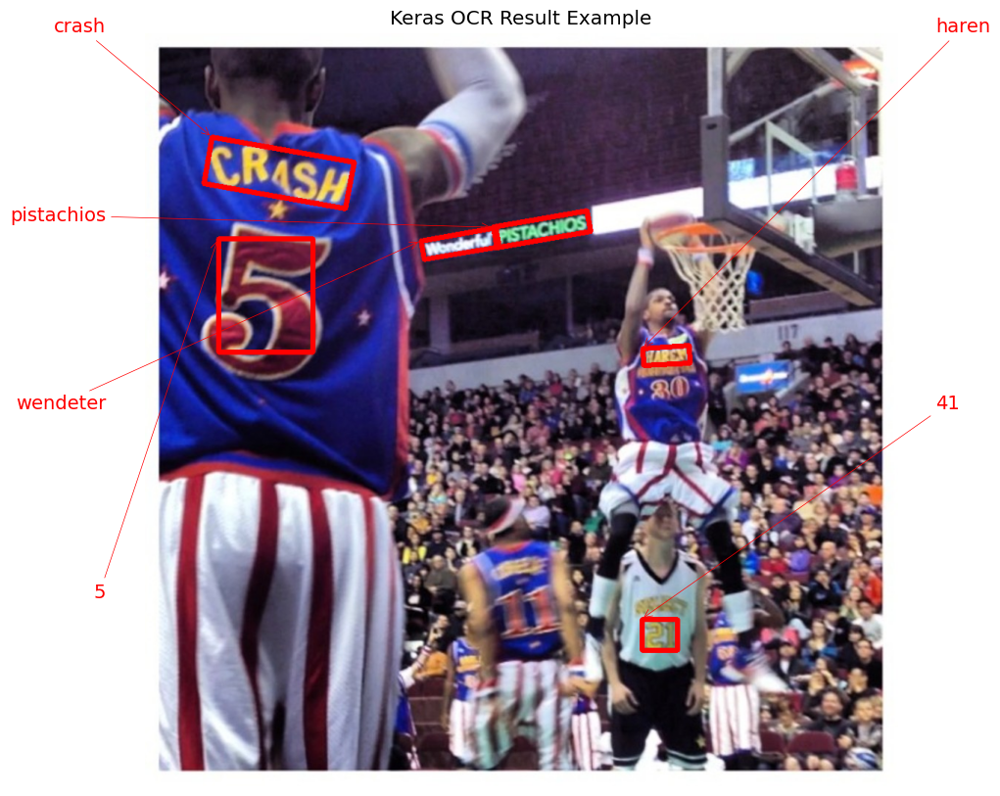

In [ ]:
fig, ax = plt.subplots(figsize=(10, 10))
keras_ocr.tools.drawAnnotations(plt.imread(img_fns[11]), results[0], ax=ax)
ax.set_title('Keras OCR Result Example')
plt.show()

# Compare easyocr vs. keras_ocr

In [ ]:
# easyocr
reader = easyocr.Reader(['en'], gpu = True)

dfs = []
for img in tqdm(img_fns[:25]):
    result = reader.readtext(img)
    img_id = img.split('/')[-1].split('.')[0]
    img_df = pd.DataFrame(result, columns=['bbox','text','conf'])
    img_df['img_id'] = img_id
    dfs.append(img_df)
easyocr_df = pd.concat(dfs)

  0%|          | 0/25 [00:00<?, ?it/s]

In [ ]:
# keras_ocr
pipeline = keras_ocr.pipeline.Pipeline()

dfs = []
for img in tqdm(img_fns[:25]):
    results = pipeline.recognize([img])
    result = results[0]
    img_id = img.split('/')[-1].split('.')[0]
    img_df = pd.DataFrame(result, columns=['text', 'bbox'])
    img_df['img_id'] = img_id
    dfs.append(img_df)
kerasocr_df = pd.concat(dfs)

Looking for /root/.keras-ocr/craft_mlt_25k.h5
Looking for /root/.keras-ocr/crnn_kurapan.h5


  0%|          | 0/25 [00:00<?, ?it/s]

1/1 [==============================] - 3s 3s/step


1/1 [==============================] - 4s 4s/step


# Plot Results: easyocr vs keras_ocr

In [ ]:
def plot_compare(img_fn, easyocr_df, kerasocr_df):
    img_id = img_fn.split('/')[-1].split('.')[0]
    fig, axs = plt.subplots(1, 2, figsize=(15, 10))

    easy_results = easyocr_df.query('img_id == @img_id')[['text','bbox']].values.tolist()
    easy_results = [(x[0], np.array(x[1])) for x in easy_results]
    keras_ocr.tools.drawAnnotations(plt.imread(img_fn),
                                    easy_results, ax=axs[0])
    axs[0].set_title('easyocr results', fontsize=24)

    keras_results = kerasocr_df.query('img_id == @img_id')[['text','bbox']].values.tolist()
    keras_results = [(x[0], np.array(x[1])) for x in keras_results]
    keras_ocr.tools.drawAnnotations(plt.imread(img_fn),
                                    keras_results, ax=axs[1])
    axs[1].set_title('keras_ocr results', fontsize=24)
    plt.show()

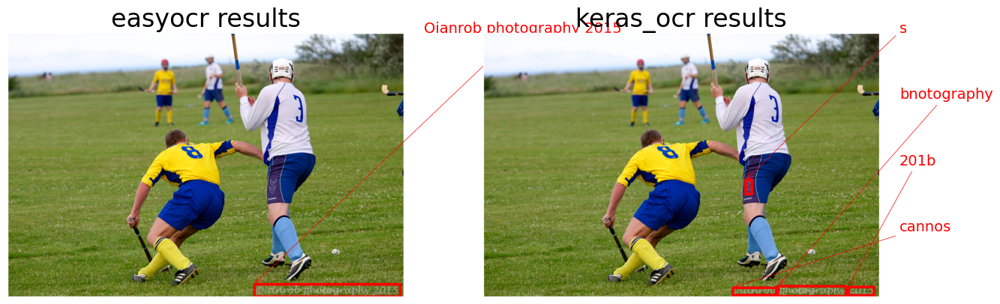

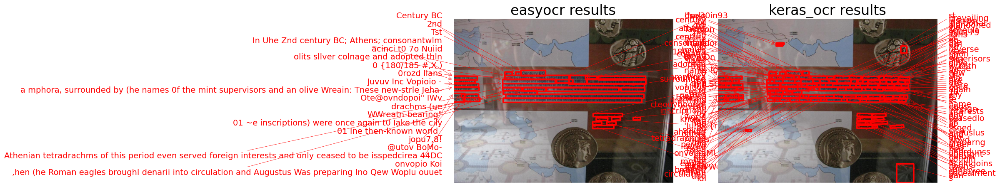

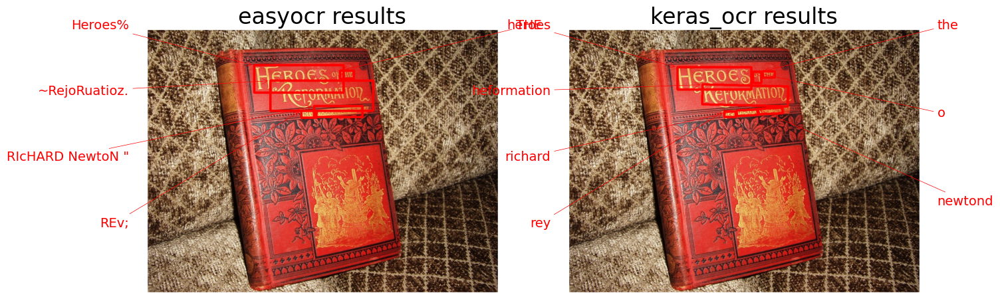

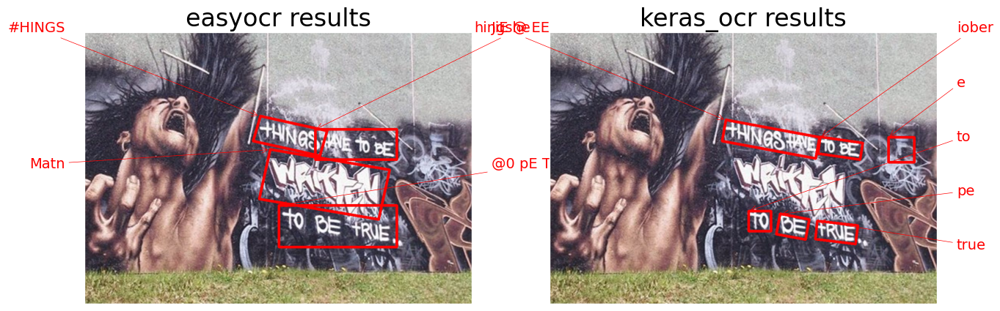

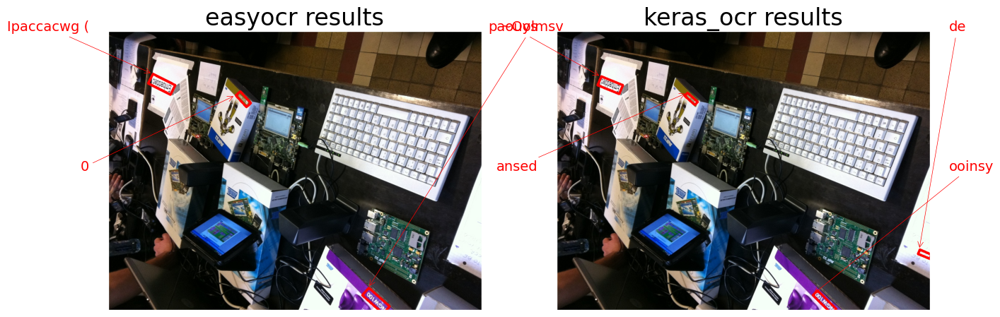

...

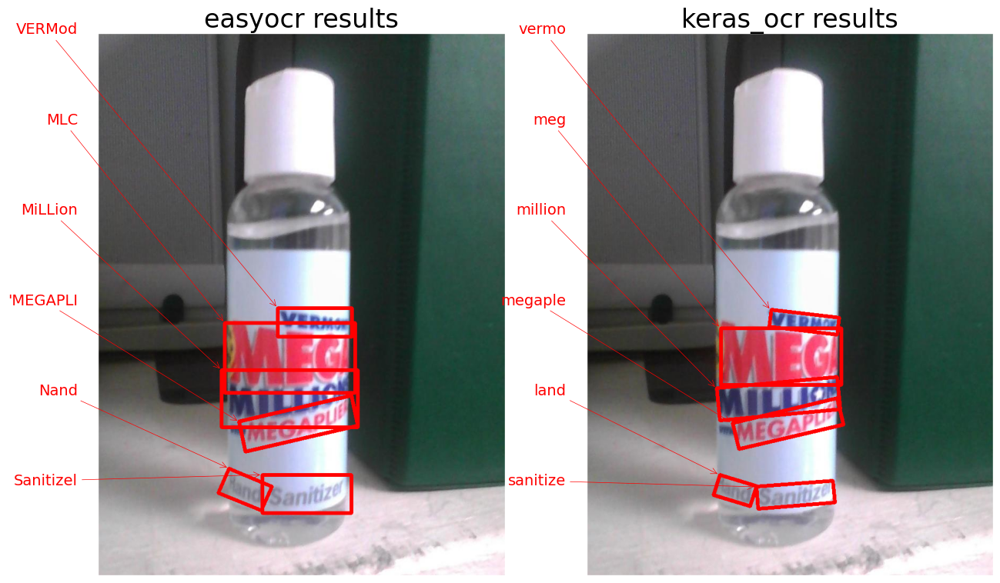

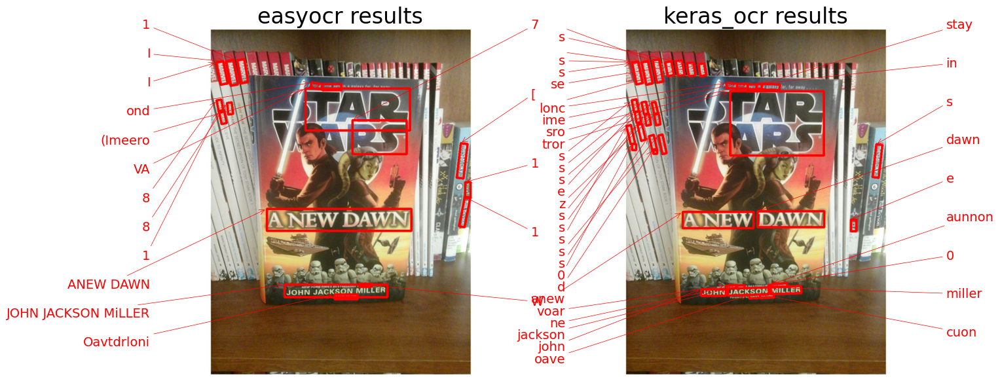

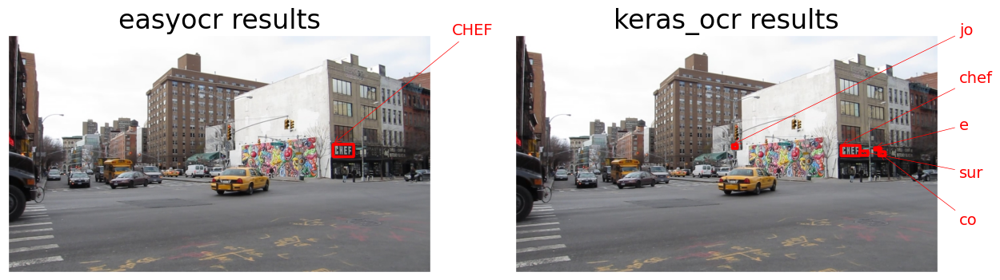

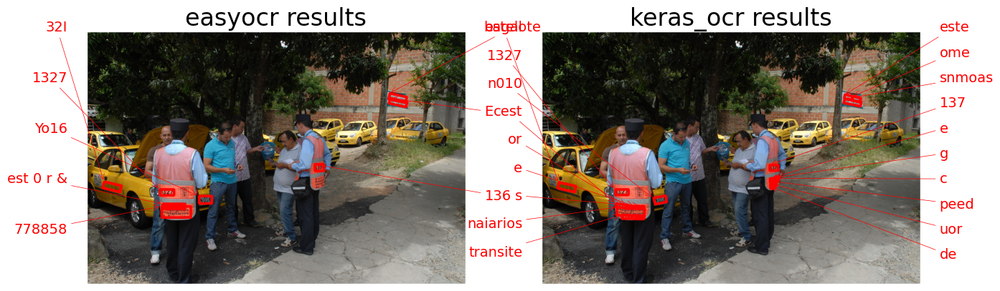

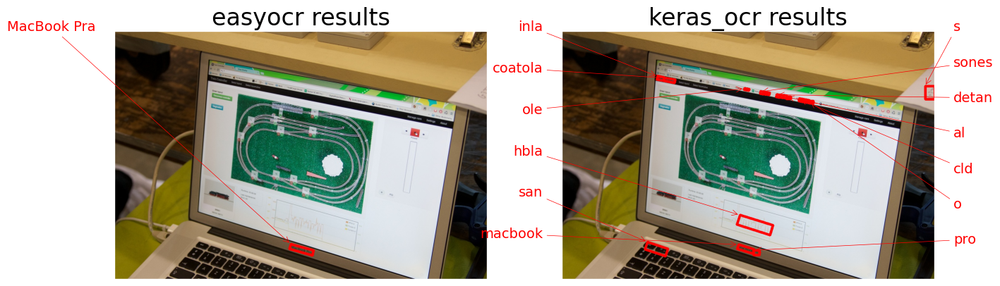

In [ ]:
# Loop over results
for img_fn in img_fns[:25]:
    plot_compare(img_fn, easyocr_df, kerasocr_df)

# The End